# HPA

In [ ]:
# @title
# Setup

# ! pip -qq install pycocotools

import os
import json
import cv2

from math import ceil

import torch

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import core
import datasets

palette = "Set2"
sns.set(style="whitegrid", font_scale=0.8, palette=palette)

def imshow(x, **kwargs):
    plt.imshow(x, **kwargs)
    plt.axis("off")

def imsshow(images, titles=None, figsize=None, rows=None, cols=None):
    if cols is None: cols = min(len(images), 8)
    if rows is None: rows = ceil(len(images) / cols)
    if figsize is None: figsize = (2*cols, 3*rows)
    plt.figure(figsize=figsize)
    for i, image in enumerate(images):
        plt.subplot(rows, cols, i+1)
        imshow(image)
        if titles is not None:
            plt.title(titles[i])
    plt.tight_layout()
    # plt.subplots_adjust(wspace=0.0, hspace=0.0)

In [ ]:
DATASETS_DIR = "/home/ldavid/workspace/datasets"
DATA_DIR = f"{DATASETS_DIR}/hpa-single-cell"

CELLS_MASK_DIR = os.path.join(DATA_DIR, "cell_masks")

ts = datasets.custom_data_source("hpa-single-cell-classification", DATA_DIR)
vs = datasets.custom_data_source("hpa-single-cell-classification", DATA_DIR, "valid")

CLASSES = ts.classification_info.classes

train_info: (21806, 2)
train: 19625
valid: 2181
train_info: (21806, 2)
train: 19625
valid: 2181


## Overview

In [ ]:
# @title
# Utils

def plot_targets_distribution(t):
    f = t.sum(0)
    o = np.argsort(-f)
    samples = len(t)
    c = np.asarray([c[:2] + "." + c[-3:] for c in CLASSES])

    plt.figure(figsize=(15, 5))
    plt.subplot(131)
    # names = [f"{a} ({b:.0%})" for a,b in zip(c[o], f[o]/samples)]
    names = c[o]
    ax = sns.barplot(x=names, y=f[o], hue=names, palette=palette, estimator="sum")
    for e in ax.containers: ax.bar_label(e, fontsize=6);
    ax.set(xlabel="Label frequency")
    plt.xticks(rotation=90)

    plt.subplot(132)
    x, f = np.unique(["-".join(c[y==1.0]) for y in t], return_counts=True)
    o = np.argsort(-f)
    n = 40
    # names = [f"{a} ({b:.0%})" for a,b in zip(x[o], f[o]/samples)]
    names = x[o]
    ax = sns.barplot(x=names[:n], y=f[o][:n], hue=names[:n], palette=palette)
    for e in ax.containers: ax.bar_label(e, fontsize=6);
    ax.set(xlabel="Label co-frequency")
    plt.xticks(rotation=90)

    plt.subplot(133)
    f = t.T @ t
    f /= np.diag(f)[:, None]
    with sns.plotting_context():
        sns.heatmap(f, annot=True, mask=f<0.05, fmt=".0%", cmap="RdPu", xticklabels=c, yticklabels=c, cbar=False, annot_kws={"fontsize": 6}).set(xlabel="Co-occurrence")
        plt.tight_layout()
    plt.subplots_adjust(hspace=0., wspace=0.2)

In [ ]:
train_targets = np.asarray([ts.get_label(sample_id) for sample_id in ts.sample_ids])
valid_targets = np.asarray([vs.get_label(sample_id) for sample_id in vs.sample_ids])

In [ ]:
pd.DataFrame(np.stack((train_targets.sum(0), valid_targets.sum(0))).astype("uint"), index=["train", "val"], columns=c)

NameError: name 'c' is not defined

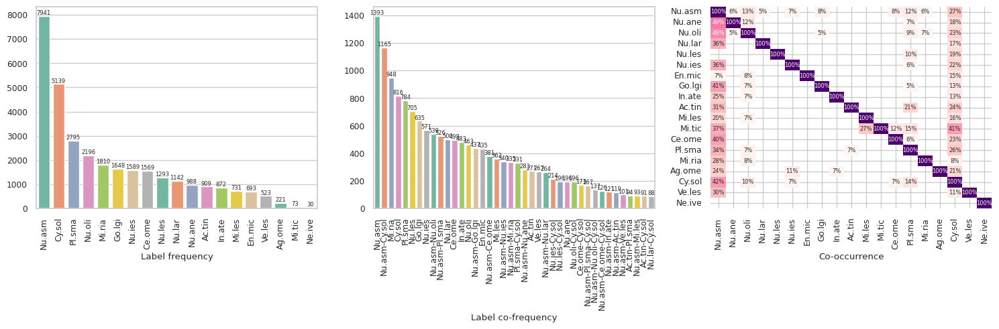

In [ ]:
plot_targets_distribution(train_targets)

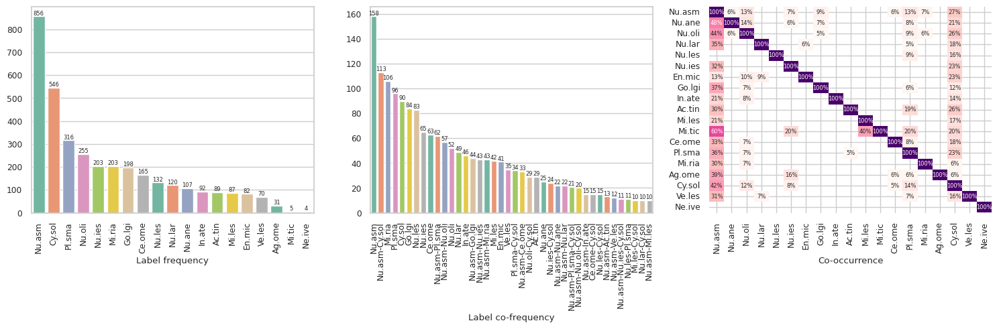

In [ ]:
plot_targets_distribution(valid_targets)

## Examples

min=0.0 mean=0.04653758183121681 max=1.0


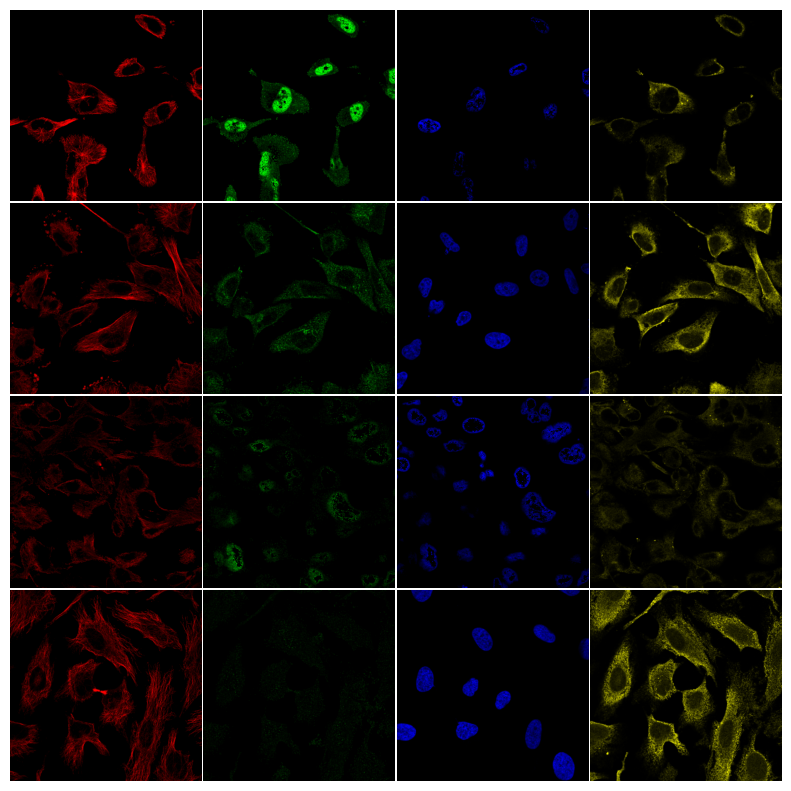

In [ ]:
#@title Vanilla RGBY

RGBY = np.asarray([
  [1.,0.,0.],
  [0.,1.,0.],
  [0.,0.,1.],
  [1.,1.,0.],
]).reshape((1, 4, 1, 1, 3))

norm_stats = (np.zeros(4), np.ones(4))

tt, tv = datasets.get_classification_transforms(512, 512, 512, "none", norm_stats)
tds = datasets.ClassificationDataset(ts, transform=tt)
tdl = torch.utils.data.DataLoader(tds, batch_size=4, drop_last=True, num_workers=1)

batch0 = next(iter(tdl))
b0_images = (batch0[1].unsqueeze(-1).numpy() * RGBY)
H, W = b0_images.shape[-3:-1]

e = batch0[1][0].numpy()
print(f"min={e[0].min()} mean={e[0].mean()} max={e[1].max()}")

imsshow(b0_images.reshape((-1, H, W, 3)), cols=4, figsize=(8, 8))
plt.subplots_adjust(hspace=0.01, wspace=0.01)

min=0.0 mean=0.07717230916023254 max=1.0


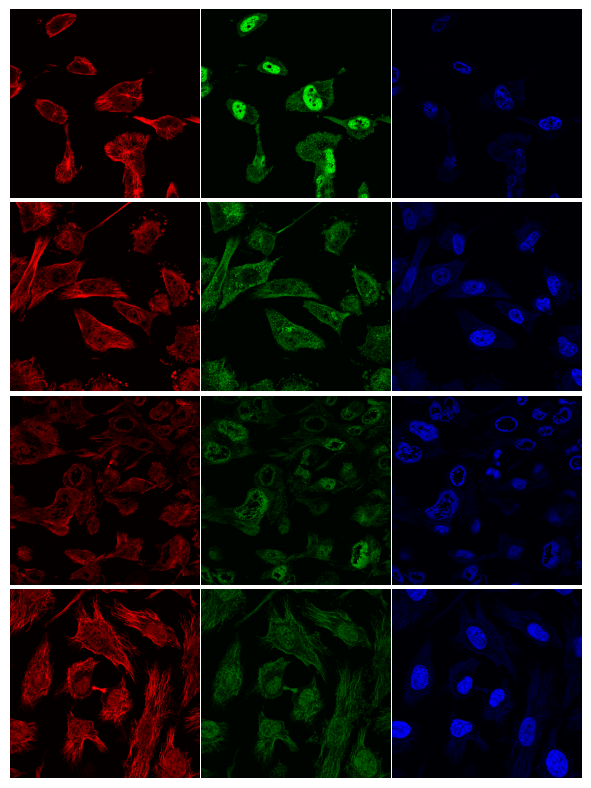

In [ ]:
#@title Clahe Augmentation (sample samples, Y channel dropped)

tt, tv = datasets.get_classification_transforms(512, 512, 512, "clahe", norm_stats)
tds = datasets.ClassificationDataset(ts, transform=tt)
tdl = torch.utils.data.DataLoader(tds, batch_size=4, drop_last=True, num_workers=1)

batch0 = next(iter(tdl))
b0_images = (batch0[1].unsqueeze(-1).numpy() * RGBY[:, :3, ...])
H, W = b0_images.shape[-3:-1]

e = batch0[1][0].numpy()
print(f"min={e[0].min()} mean={e[0].mean()} max={e[1].max()}")

imsshow(b0_images.reshape((-1, H, W, 3)), cols=3, figsize=(3*2, 4*2))
plt.subplots_adjust(hspace=0.01, wspace=0.01)

## Exporting to RGB

In [ ]:
from PIL import Image

In [ ]:
classes = ts.classification_info.classes

for _id, _class in enumerate(classes):
    file_path = f"/home/ldavid/workspace/datasets/hpa-single-cell/ImageSets/{_id}.txt"
    save_dir = f"/home/ldavid/workspace/datasets/hpa-single-cell/ImageSets/{_id}"

    print(f"RGBing {_class} images", end="")

    os.makedirs(save_dir, exist_ok=True)

    with open(file_path) as f:
        sample_ids = [l.strip() for l in f.readlines()]

    for i, sample_id in enumerate(sample_ids):
        out_file = f"{save_dir}/{sample_id}.jpg"
        if os.path.exists(out_file): continue

        image = vs.get_image(sample_id)
        image = np.array(image)

        Image.fromarray(image[..., :3]).save(out_file)
        print(".", end="\n" if (i+1) % 32 == 0 else "")
    print(" done.")

RGBing Nucleoplasm images................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
................................
..................

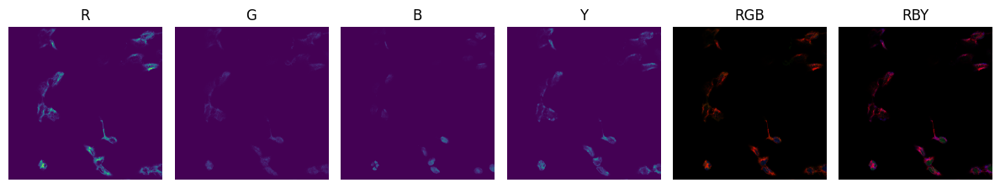

In [ ]:
plt.figure(figsize=(12, 3))
plt.subplot(161) and plt.title("R") and imshow(image[..., 0])
plt.subplot(162) and plt.title("G") and imshow(image[..., 1])
plt.subplot(163) and plt.title("B") and imshow(image[..., 2])
plt.subplot(164) and plt.title("Y") and imshow(image[..., 3])
plt.subplot(165) and plt.title("RGB") and imshow(image[..., [0, 1, 2]])
plt.subplot(166) and plt.title("RBY") and imshow(image[..., [0, 2, 3]])
# plt.subplot(247) and plt.title("RBY") and imshow(image[..., [0, 1, 2]])
# plt.subplot(248) and plt.title("RGB") and imshow(image[..., [0, 1, 2]])
plt.tight_layout();

## Classification

In [ ]:
#@title Utils

from sklearn.metrics import classification_report

def onehot(x, n=19):
  o = np.zeros(n, dtype="int32")
  o[x] = 1
  return o

def sigmoid(x):
  return 1/(1+np.exp(-x))

def entropy(x, y):
  return -y*np.log(x) -(1-y)*np.log(1-x)

def plot_pos_neg_entropy(mask, pos_mask, neg_mask):
  plt.figure(figsize=(6, 2))
  plt.subplot(121)
  sns.histplot(entropy_report[mask & pos_mask].entropy, kde=True)
  plt.xlim([0., 0.5])

  plt.subplot(122)
  sns.histplot(entropy_report[mask & neg_mask].entropy, kde=True)
  plt.xlim([0., 0.5])

  plt.tight_layout()

In [ ]:
# LOGITS_PATH = "../experiments/predictions/vanilla/hpa-single-cell-classification-rs101-lr0.1-r1-valid-logit.npz"
LOGITS_PATH = "../experiments/predictions/vanilla/hpa-single-cell-classification-rs269-lr0.1-r1-logit.npz"
REPORT_PATH = "../experiments/logs/vanilla/entropy_report-rs269-valid.csv"

bunch = np.load(LOGITS_PATH)

sample_id = bunch["sample_id"]
logit = bunch["logit"]

prob = sigmoid(logit).clip(0.001, 0.999)

target = np.stack([vs.sample_labels[_id] for _id in sample_id], 0)

is_singleton = target.sum(1) == 1

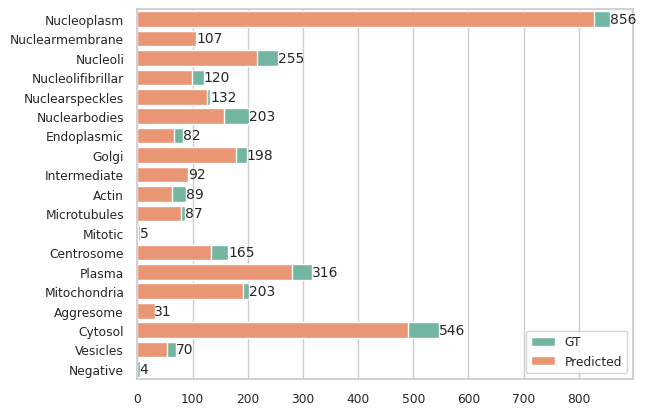

In [ ]:
#@title GT Freq. $\times$ Pred@50% Freq. (not necessarily the same samples)

ax = sns.barplot(x=target.sum(0), y=CLASSES, label="GT", estimator="sum")
ax.bar_label(ax.containers[0], fontsize=10);
sns.barplot(x=(prob > 0.5).sum(0), y=CLASSES, label="Predicted");

In [ ]:
#@title Classification Report (Metrics)

print(classification_report(target, (prob>0.5), target_names=CLASSES, zero_division=0))

                   precision    recall  f1-score   support

      Nucleoplasm       0.86      0.83      0.84       856
  Nuclearmembrane       0.86      0.85      0.85       107
         Nucleoli       0.82      0.69      0.75       255
Nucleolifibrillar       0.76      0.62      0.68       120
  Nuclearspeckles       0.82      0.78      0.80       132
    Nuclearbodies       0.74      0.57      0.64       203
      Endoplasmic       0.66      0.54      0.59        82
            Golgi       0.85      0.77      0.81       198
     Intermediate       0.77      0.77      0.77        92
            Actin       0.86      0.61      0.71        89
     Microtubules       0.92      0.84      0.88        87
          Mitotic       1.00      0.20      0.33         5
       Centrosome       0.79      0.64      0.70       165
           Plasma       0.74      0.66      0.70       316
     Mitochondria       0.80      0.75      0.77       203
        Aggresome       0.78      0.81      0.79       

### Entropy

In [ ]:
e = entropy(prob, target)

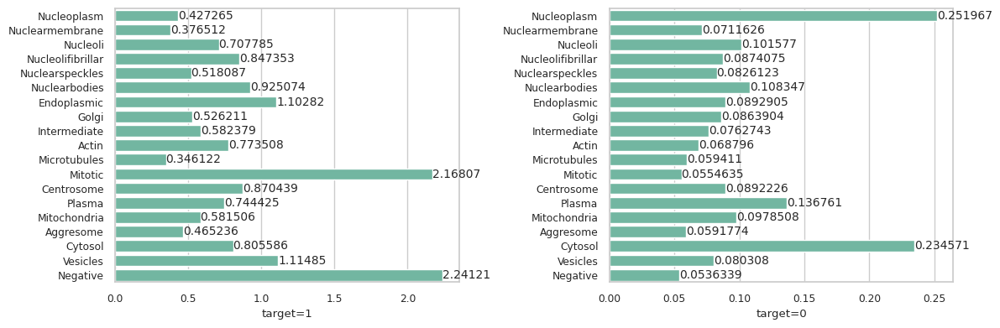

In [ ]:
#@title Entropy for Positives and Negatives

plt.figure(figsize=(12, 4))
plt.subplot(121)
ax = sns.barplot(x=((e*target).sum(0) / target.sum(0)), y=CLASSES, estimator="sum")
ax.bar_label(ax.containers[0], fontsize=10)
plt.xlabel("target=1")

plt.subplot(122)
ax = sns.barplot(x=((e*(1-target)).sum(0) / (1-target).sum(0)), y=CLASSES, estimator="sum")
ax.bar_label(ax.containers[0], fontsize=10);
plt.xlabel("target=0")

plt.tight_layout()

In [ ]:
#@title report building

_files = []
_classes = []
_probs = []
_rels = []
_entropies = []

for class_ix in range(19):
  class_mask = target[:, class_ix] == 1.0
  e_class_pos = e[class_mask, class_ix]
  e_class_neg = e[~class_mask, class_ix]

  c = CLASSES[class_ix]

  n = len(e_class_pos)
  _files.append(sample_id[class_mask])
  _probs.append(prob[class_mask, class_ix])
  _entropies.append(e_class_pos)
  _classes.append(np.asarray([c] * n))
  _rels.append(np.asarray(["positive"] * n))

  n = len(e_class_neg)
  _files.append(sample_id[~class_mask])
  _probs.append(prob[~class_mask, class_ix])
  _entropies.append(e_class_neg)
  _classes.append(np.asarray([c] * n))
  _rels.append(np.asarray(["negative"] * n))

_files, _probs, _entropies, _classes, _rels = (np.concatenate(e, 0) for e in (_files, _probs, _entropies, _classes, _rels))

entropy_report = pd.DataFrame({
  "file": _files,
  "prob": _probs,
  "target": _classes,
  "relation": _rels,
  "entropy": _entropies,
})

In [ ]:
entropy_report.head()

,file,prob,target,relation,entropy
0,394adf26-bb9e-11e8-b2b9-ac1f6b6435d0,0.977051,Nucleoplasm,positive,0.023224
1,419e82b2-bb9a-11e8-b2b9-ac1f6b6435d0,0.501953,Nucleoplasm,positive,0.689453
2,e72c2e3c-bb9a-11e8-b2b9-ac1f6b6435d0,0.234863,Nucleoplasm,positive,1.449219
3,cb94513c-bb99-11e8-b2b9-ac1f6b6435d0,0.731445,Nucleoplasm,positive,0.312744
4,2e9d335a-bbb5-11e8-b2ba-ac1f6b6435d0,0.934082,Nucleoplasm,positive,0.068176


In [ ]:
if os.path.exists(REPORT_PATH):
  print(f"File {REPORT_PATH} already exists. Are you trying to override?")
else:
  entropy_report.to_csv(REPORT_PATH, index=False)

File ../experiments/logs/vanilla/entropy_report-rs269-valid.csv already exists. Are you trying to override?


#### Nucleoplasm

Class: Nucleoplasm


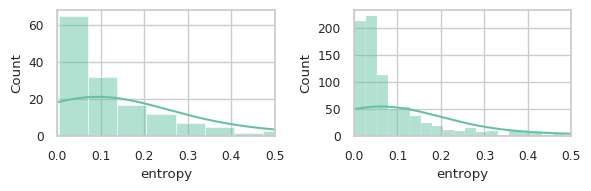

In [ ]:
# @title
# for c in CLASSES:
class_ix = 0
c = CLASSES[class_ix]

singleton_ids = sample_id[is_singleton]

print(f"Class: {c}")

mask_singleton = entropy_report.file.isin(singleton_ids)
mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Nucleoplasm positive


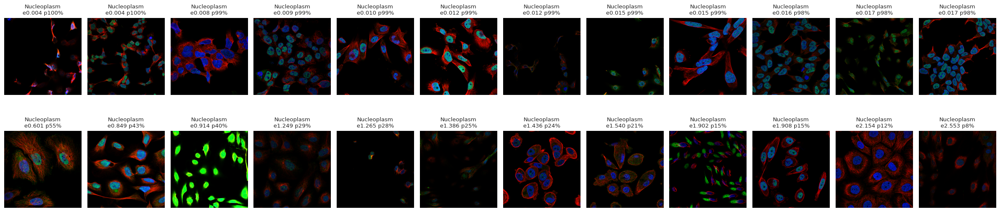

In [ ]:
# @title
print(f"Class: {c} positive")

N = 12

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Nucleoplasm negative


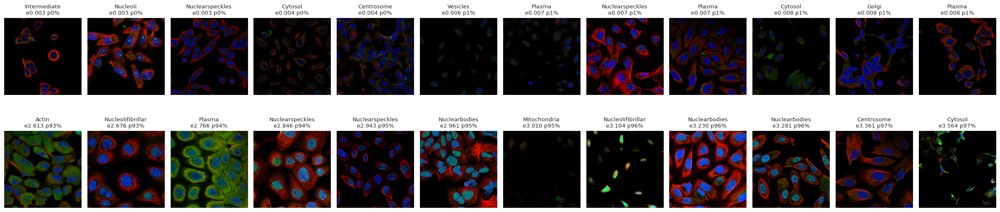

In [ ]:
# @title
print(f"Class: {c} negative")

N = 12

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Nuclear Membrane

Class: Nuclearmembrane


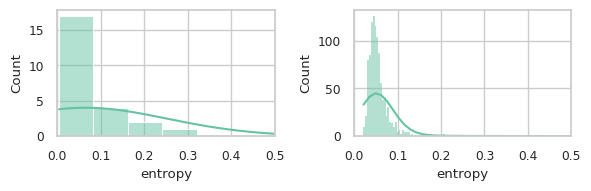

In [ ]:
# @title
# for c in CLASSES:
class_ix = 1
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Nuclearmembrane positive


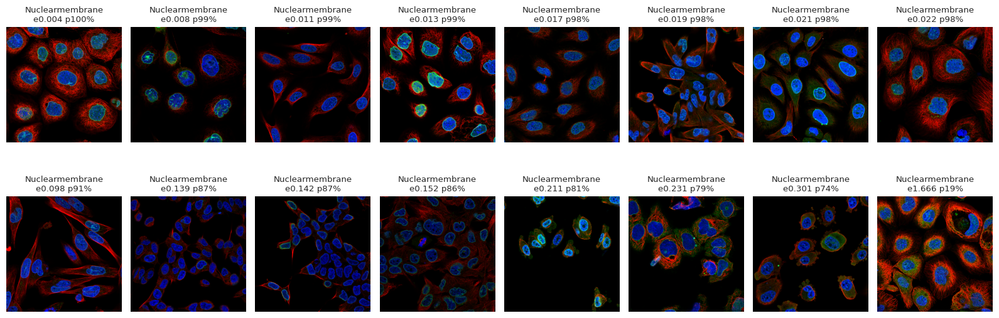

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Nuclearmembrane negative


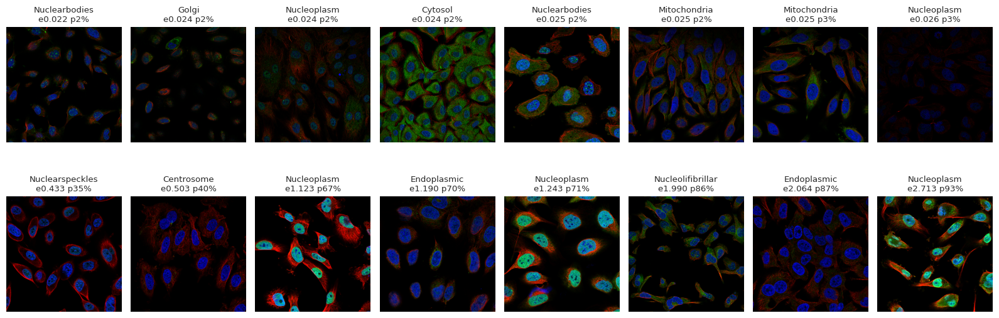

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Nucleoli

Class: Nucleoli


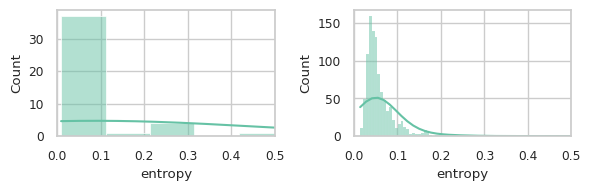

In [ ]:
# @title
# for c in CLASSES:
class_ix = 2
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Nucleoli positive


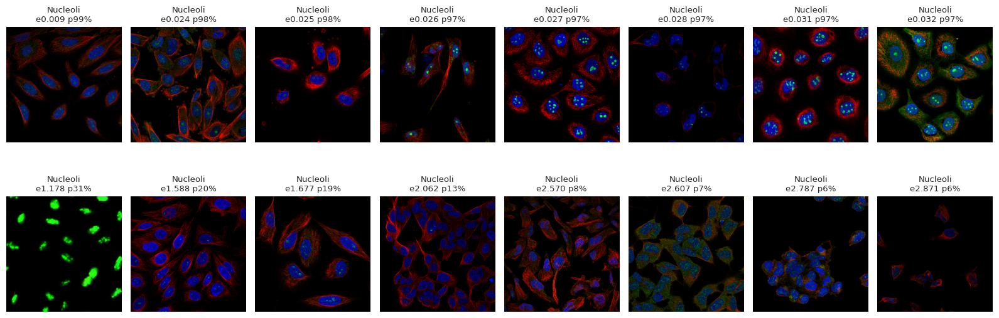

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Nucleoli negative


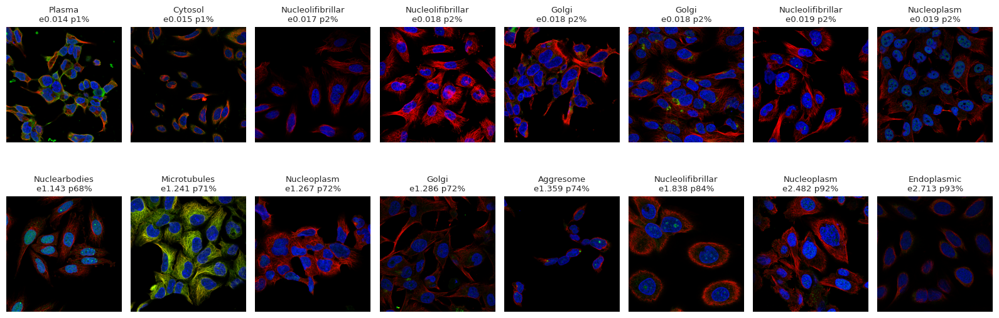

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Nucleolifibrillar

Class: Nucleolifibrillar


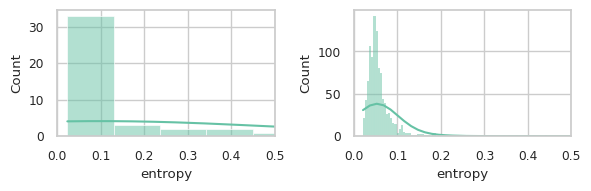

In [ ]:
# @title
# for c in CLASSES:
class_ix = 3
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Nucleolifibrillar positive


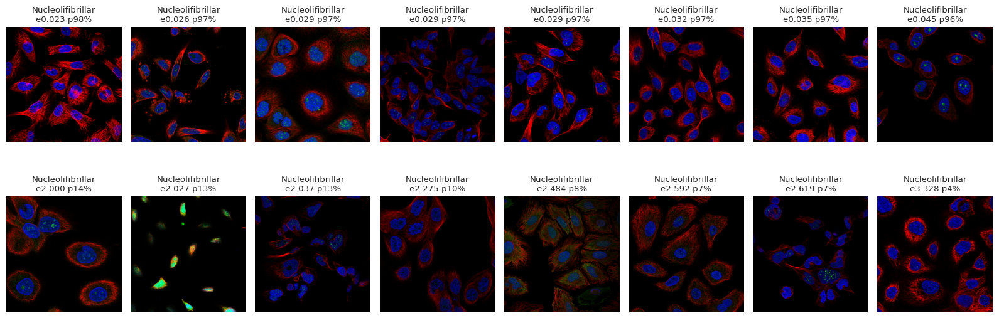

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Nucleolifibrillar negative


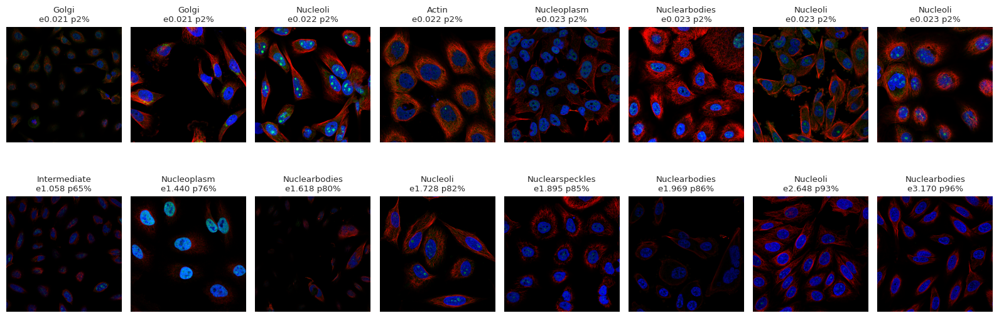

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Nuclear speckles

Class: Nuclearspeckles


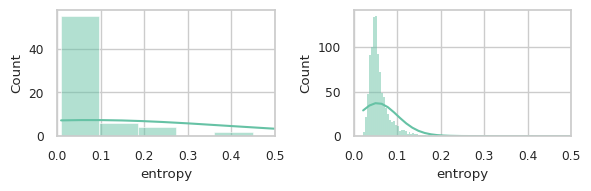

In [ ]:
# @title
# for c in CLASSES:
class_ix = 4
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Nuclearspeckles positive


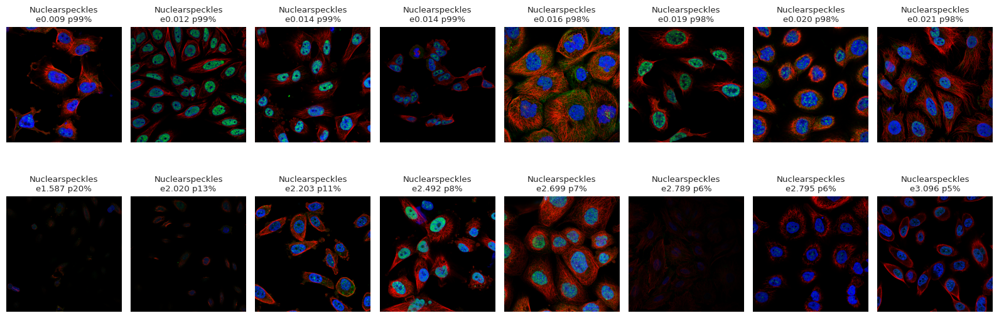

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Nuclearspeckles negative


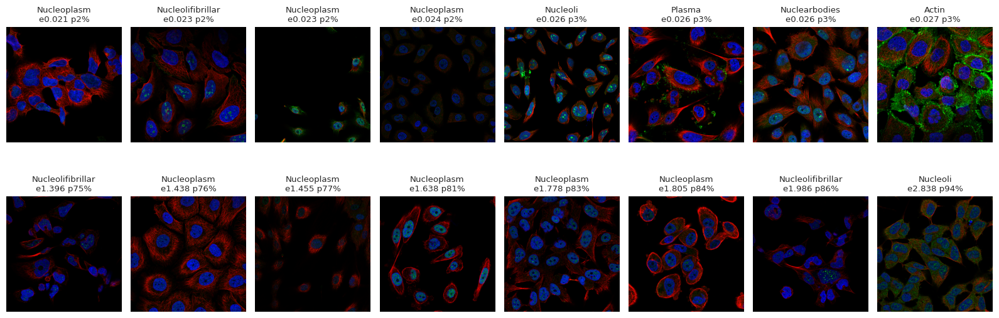

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Nuclear bodies

Class: Nuclearbodies


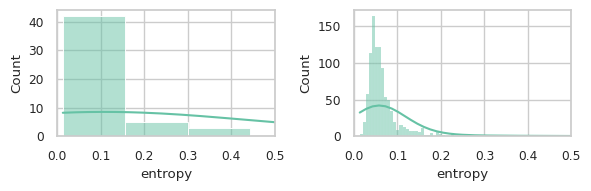

In [ ]:
# @title
# for c in CLASSES:
class_ix = 5
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Nuclearbodies positive


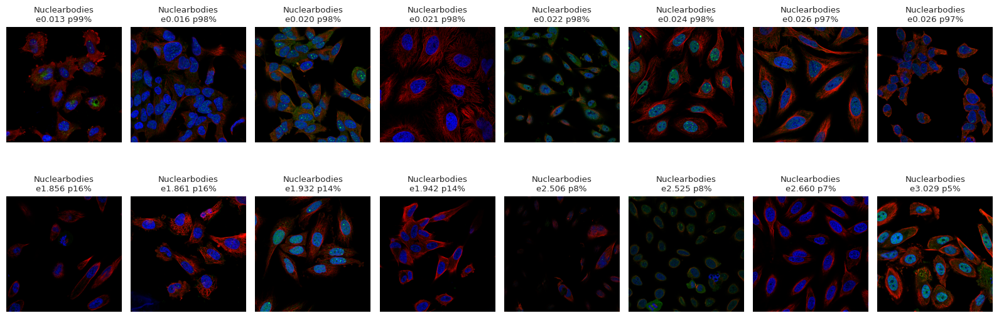

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Nuclearbodies negative


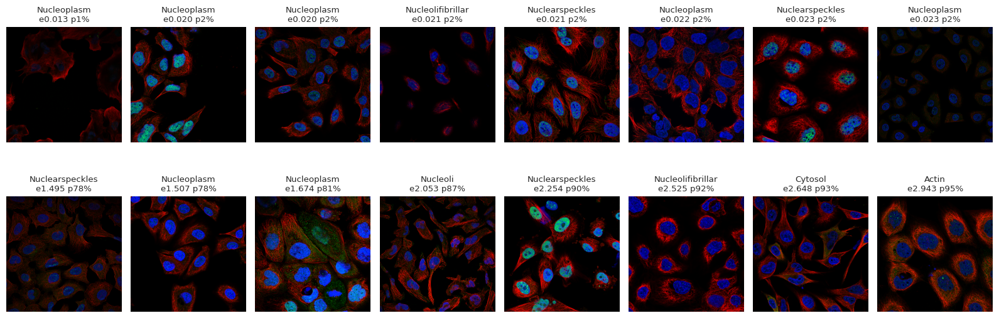

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Endoplasmic

Class: Endoplasmic


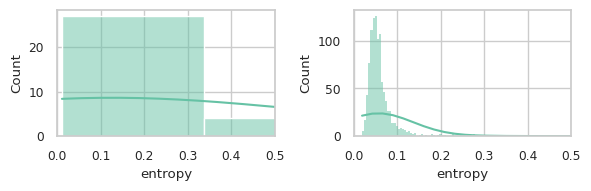

In [ ]:
# @title
# for c in CLASSES:
class_ix = 6
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Endoplasmic positive


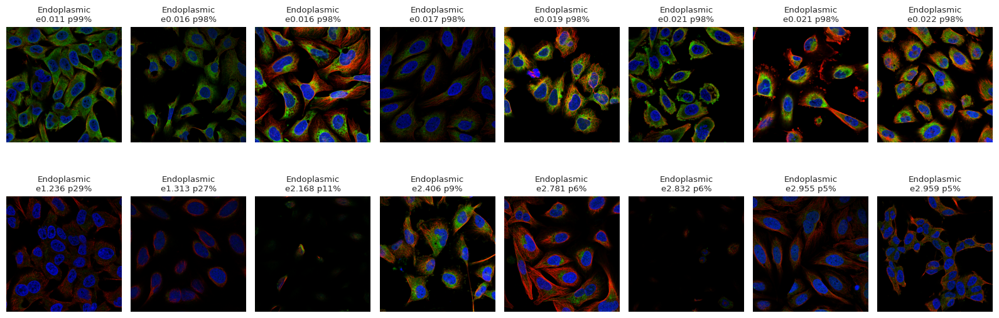

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Endoplasmic negative


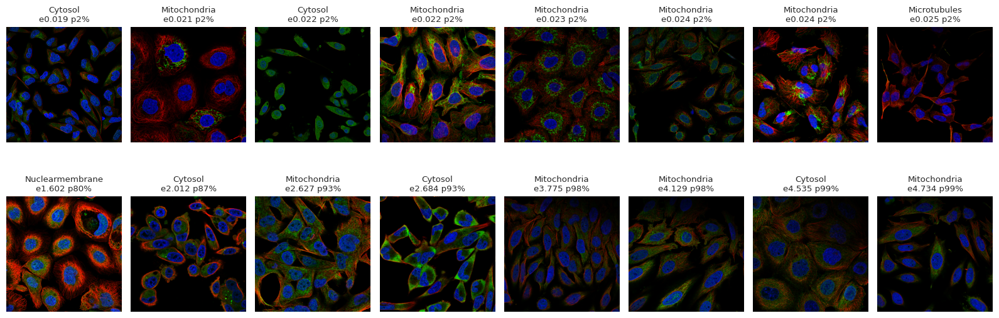

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Golgi

Class: Golgi


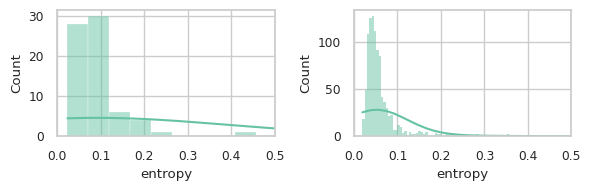

In [ ]:
# @title
# for c in CLASSES:
class_ix = 7
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Golgi positive


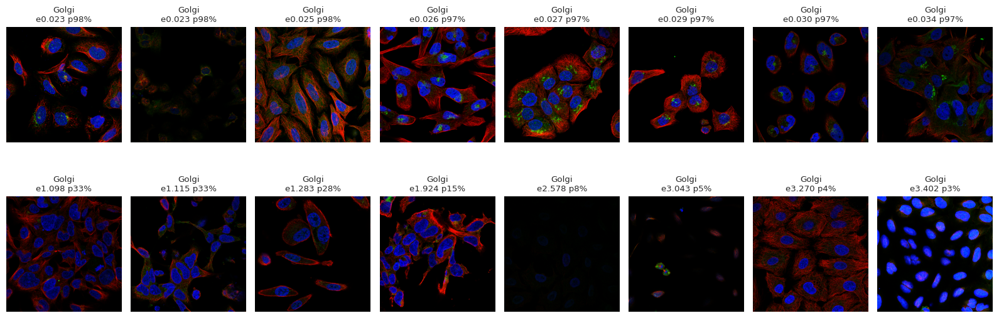

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Golgi negative


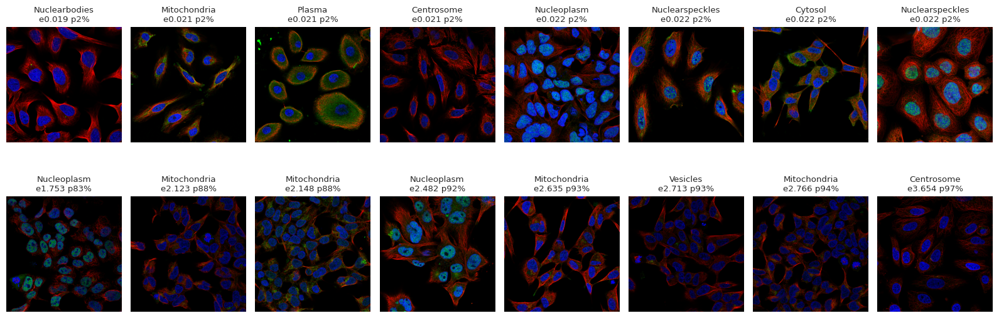

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Intermediate

Class: Intermediate


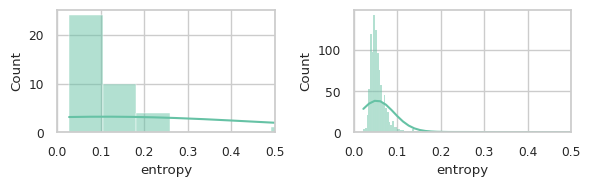

In [ ]:
# @title
# for c in CLASSES:
class_ix = 8
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Intermediate positive


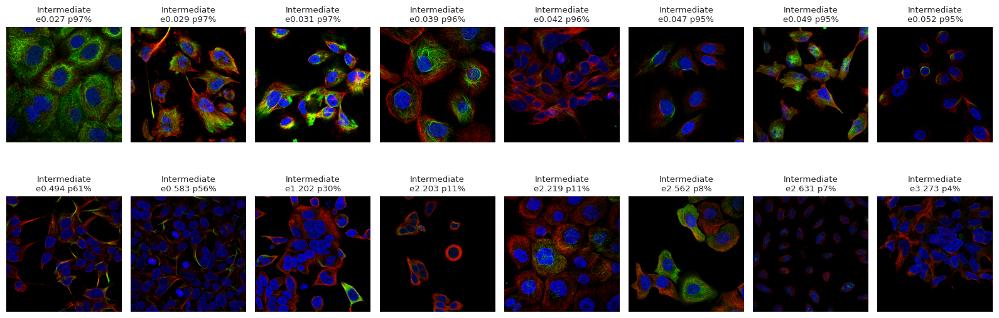

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Intermediate negative


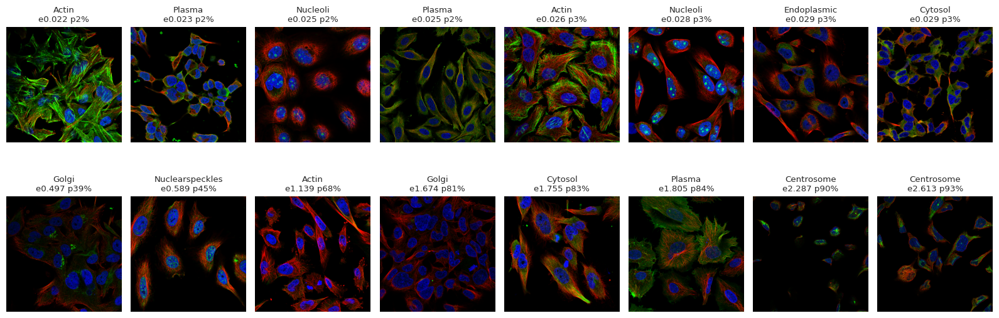

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Actin

Class: Actin


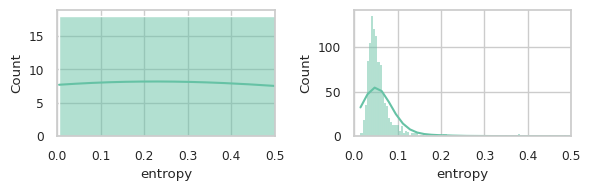

In [ ]:
# @title
# for c in CLASSES:
class_ix = 9
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Actin positive


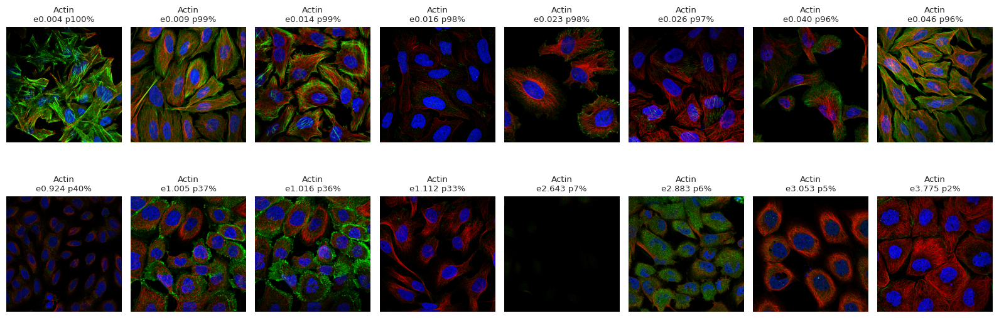

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Actin negative


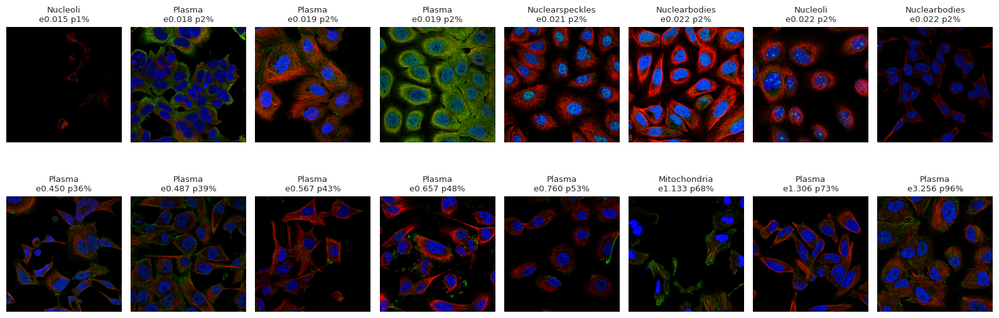

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Mitotic

Class: Mitotic


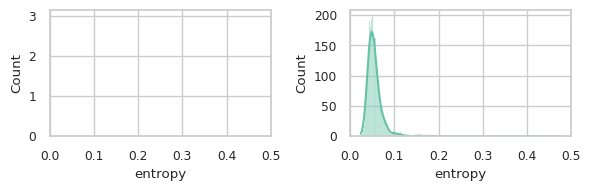

In [ ]:
# @title
# for c in CLASSES:
class_ix = 11
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) # & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Mitotic positive


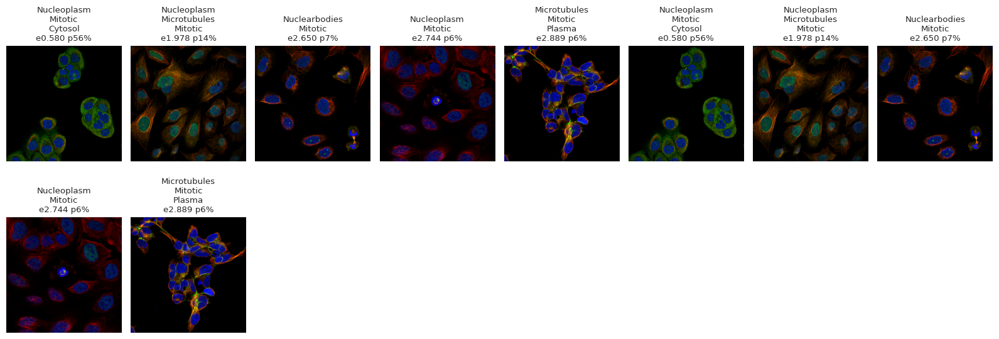

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Mitotic negative


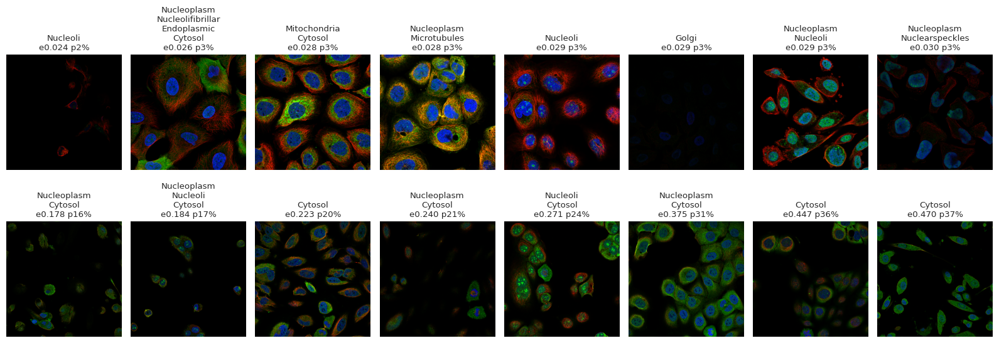

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Centrosome

Class: Centrosome


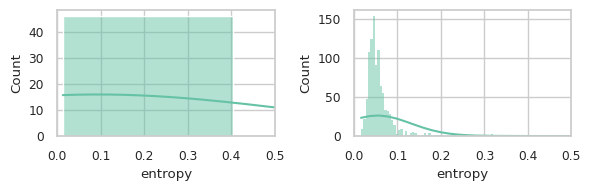

In [ ]:
# @title
# for c in CLASSES:
class_ix = 12
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Centrosome positive


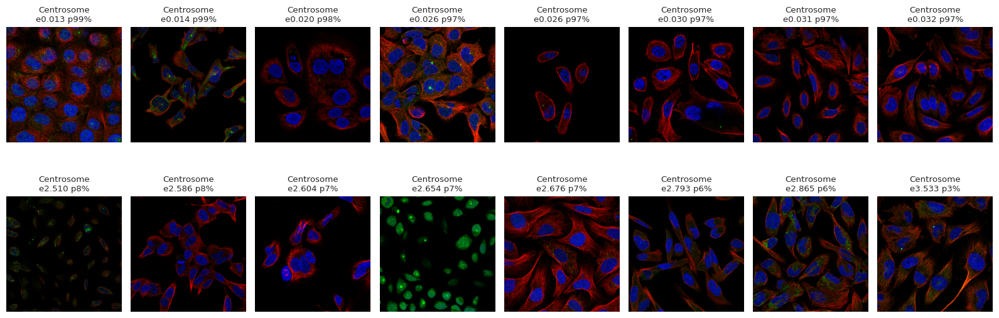

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Centrosome negative


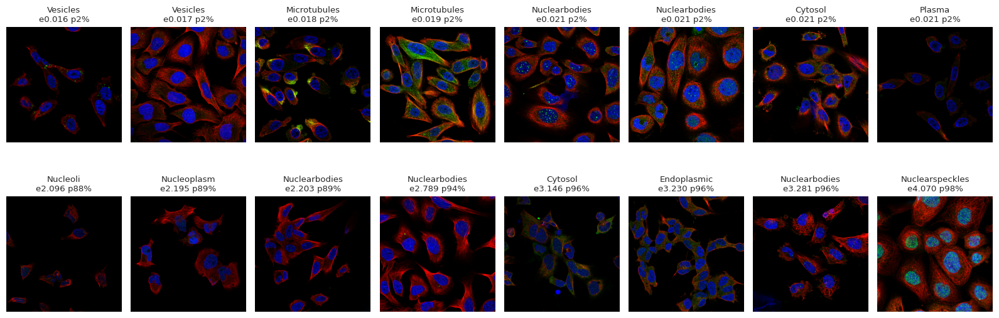

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Plasma

Class: Plasma


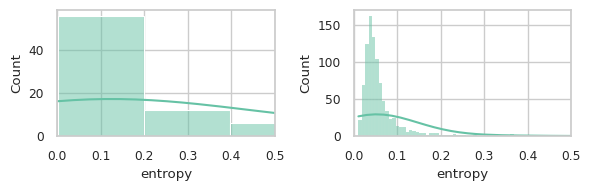

In [ ]:
# @title
# for c in CLASSES:
class_ix = 13
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Plasma positive


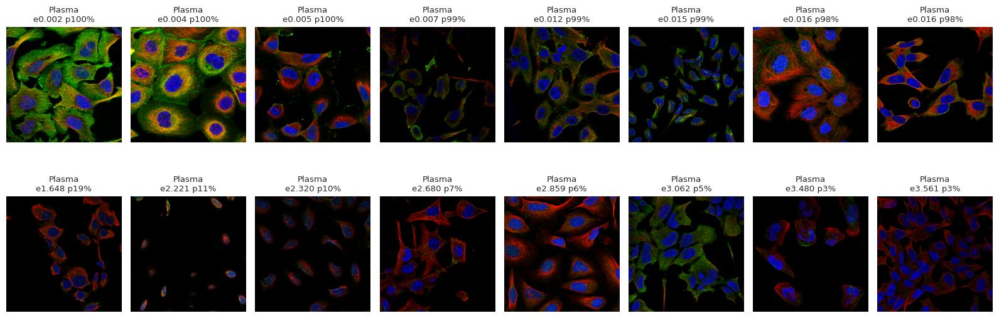

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Plasma negative


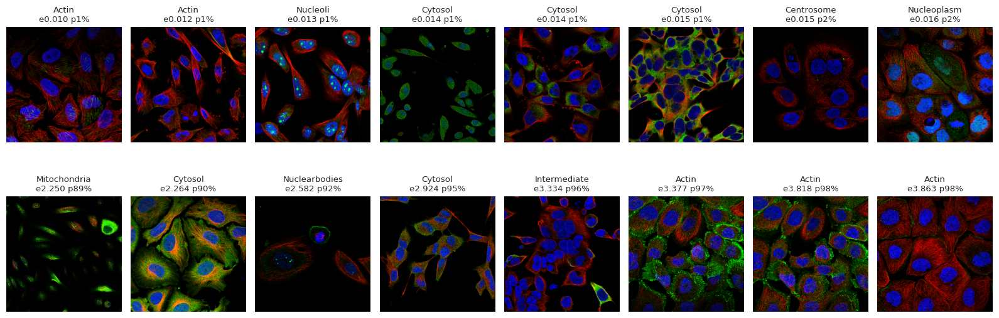

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Mitochondria

Class: Mitochondria


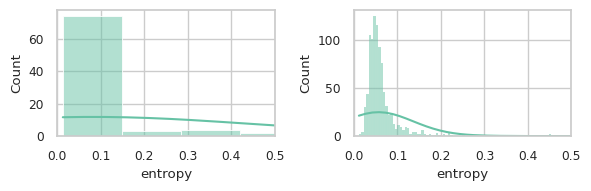

In [ ]:
# @title
# for c in CLASSES:
class_ix = 14
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Mitochondria positive


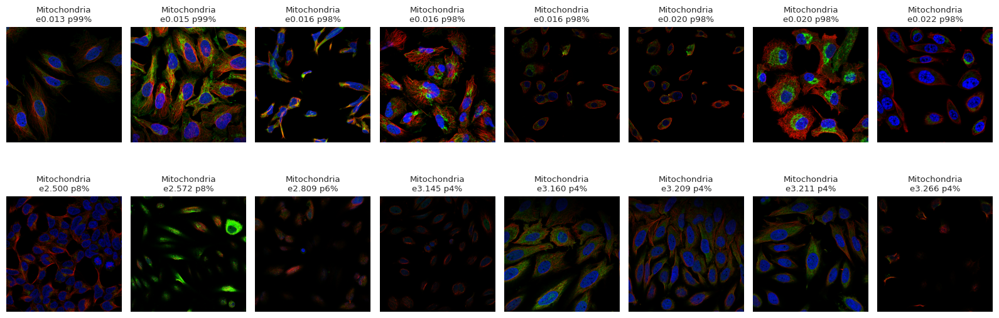

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Mitochondria negative


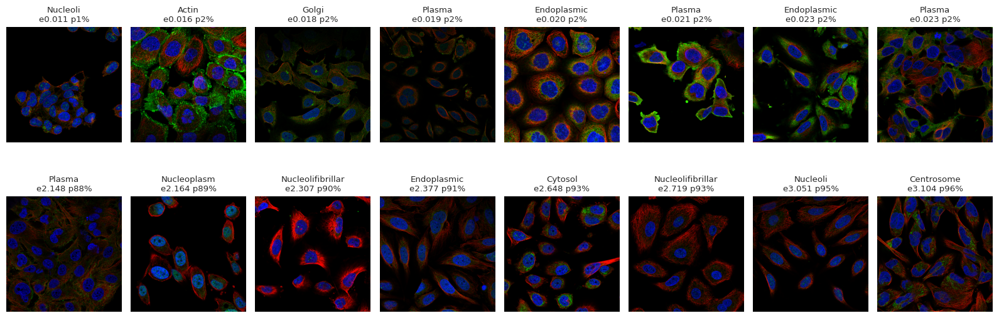

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Aggresome

Class: Aggresome


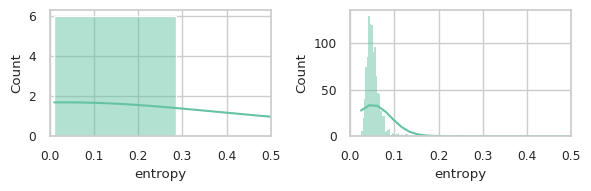

In [ ]:
# @title
# for c in CLASSES:
class_ix = 15
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Aggresome positive


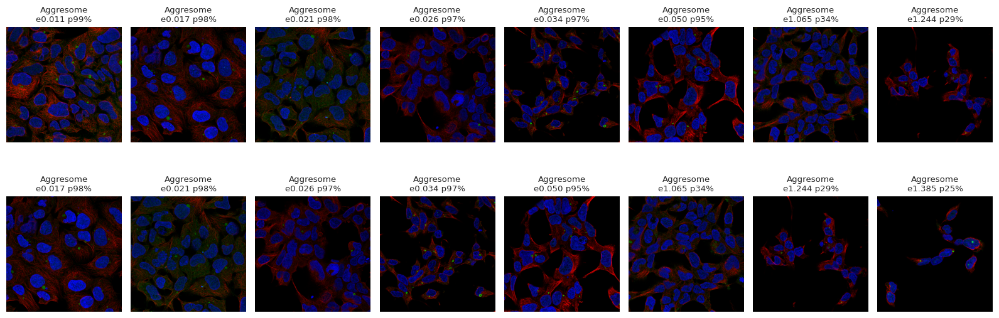

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Aggresome negative


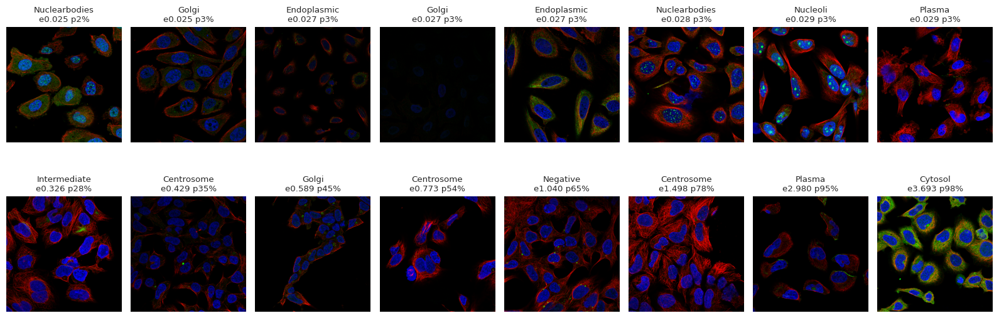

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Cytosol

Class: Cytosol


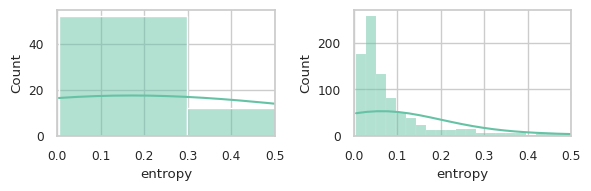

In [ ]:
# @title
# for c in CLASSES:
class_ix = 16
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Cytosol positive


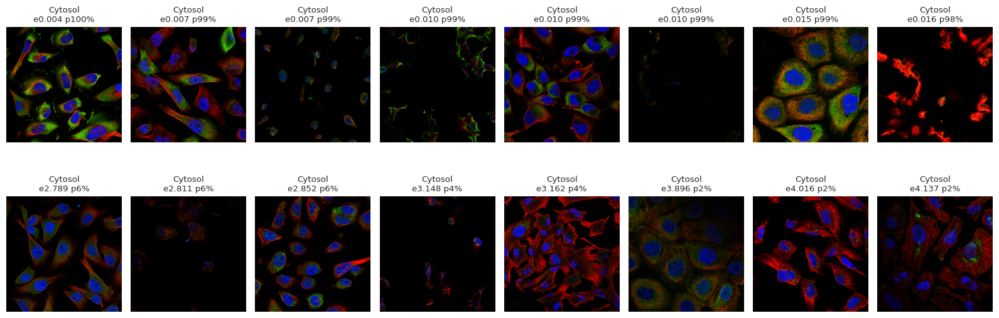

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Cytosol negative


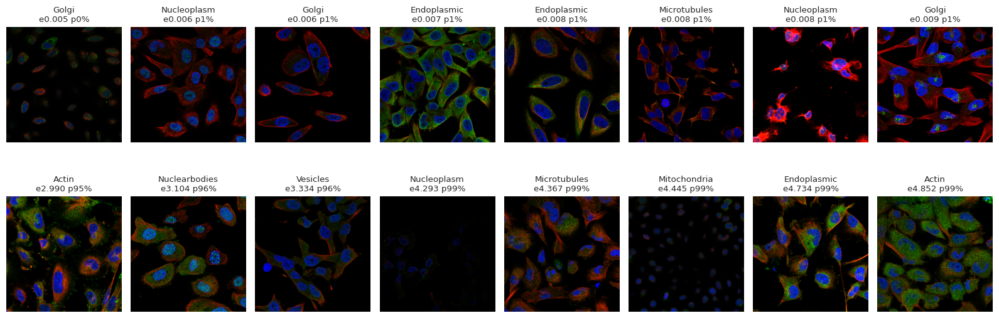

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Vesicles

Class: Vesicles


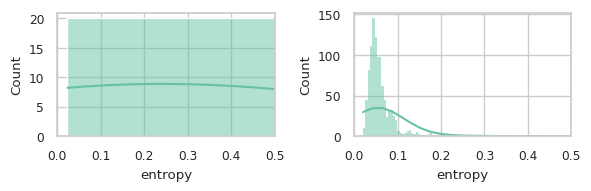

In [ ]:
# @title
# for c in CLASSES:
class_ix = 17
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Vesicles positive


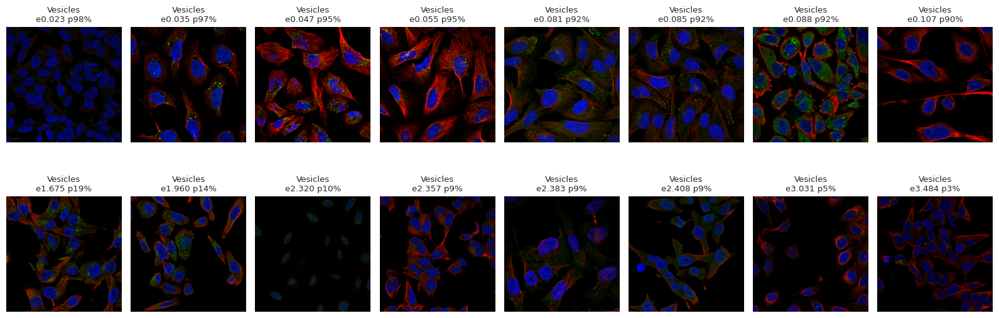

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Vesicles negative


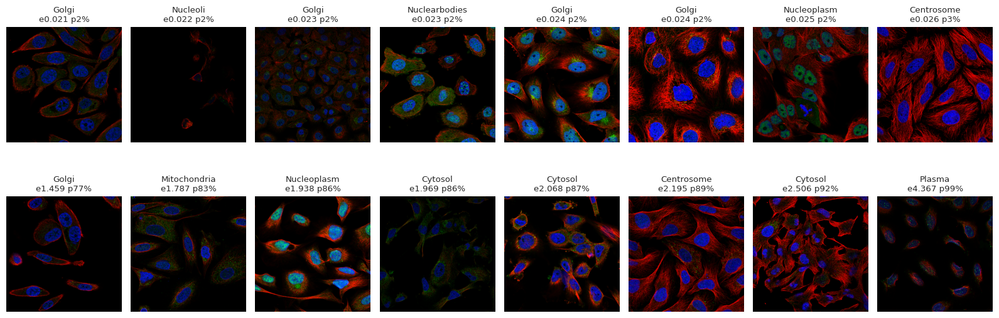

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

#### Negative

Class: Negative


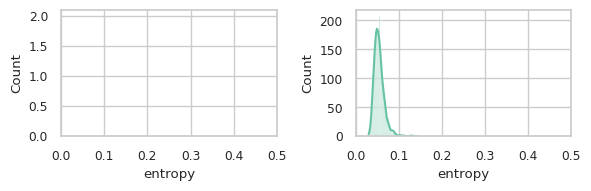

In [ ]:
# @title
# for c in CLASSES:
class_ix = 18
c = CLASSES[class_ix]

print(f"Class: {c}")

mask = (entropy_report.target == c) #  & mask_singleton
pos_mask = entropy_report.relation == "positive"
neg_mask = entropy_report.relation == "negative"
plot_pos_neg_entropy(mask, pos_mask, neg_mask)

entropy_pos = entropy_report[mask & pos_mask].sort_values("entropy")
entropy_neg = entropy_report[mask & neg_mask].sort_values("entropy")

Class: Negative positive


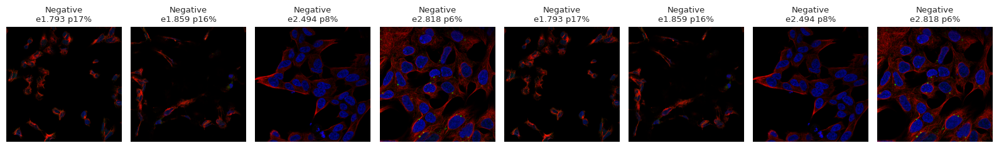

In [ ]:
# @title
print(f"Class: {c} positive")

N = 8

low_e = entropy_pos.head(N)
high_e = entropy_pos.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
# _titles = [ for _id in _ids]
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

Class: Negative negative


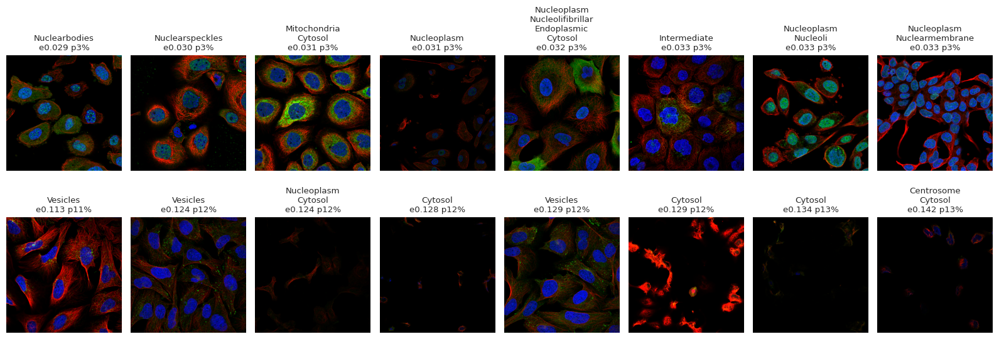

In [ ]:
# @title
print(f"Class: {c} negative")

N = 8

low_e = entropy_neg.head(N)
high_e = entropy_neg.tail(N)

low_e_ids = [_id for _id in low_e["file"]]
high_e_ids = [_id for _id in high_e["file"]]
low_e_entropy = [e for e in low_e["entropy"]]
high_e_entropy = [e for e in high_e["entropy"]]
low_p = [p for p in low_e["prob"]]
high_p = [p for p in high_e["prob"]]

_ids = low_e_ids + high_e_ids
_titles = ["\n".join(CLASSES[vs.get_label(_id) > 0.5]) + f"\ne{e:.3f} p{p:.0%}" for _id, e, p in zip(_ids, low_e_entropy+high_e_entropy,low_p+high_p)]

imsshow([np.asarray(vs.get_image(_id))[..., :3] for _id in _ids], titles=_titles, cols=N)

In [ ]:
logit_t  = ...   # np.randn((N, len(CLASSES)))
target = ...  # (np.rand(N, len(CLASSES)) > 0.5).astype("float16"))

# y*log(p)


prob_t = sigmoid(logit_t)
entropy_t = logloss(prob_t, target)

rel_entropy_t = entropy_t / entropy_t.sum(axis=0, keepdim=True)
rel_entropy_t.clip_(min=1e-5, max=1-1e-5)


def binary_ce_loss_fn_0(logit, target):
  loss = F.binary_crossentropy(logit, target)
  coherence = 1 - torch.abs(target - prob_t)

  return (coherence * loss).sum() / coherence.sum()


def binary_ce_loss_fn_1(logit, target):
  loss = F.binary_crossentropy(logit, target)

  return ((1/rel_entropy_t) * loss).sum() / (1/rel_entropy_t).sum()

## Instance Masks

### Examples

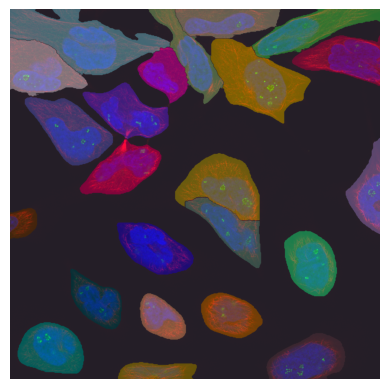

In [ ]:
# @title
def to_random_color(mask):
    n = len(np.unique(mask))
    c = np.random.rand(n, 3)
    return c[mask]

entry = np.load(os.path.join(CELLS_MASK_DIR, f"{sample_id}.npz"))

imshow(image[..., :3])
imshow(to_random_color(entry['arr_0']), alpha=0.5)

### Export to coco.json Format

In [ ]:
from itertools import groupby
from pycocotools import mask as mutils
import pycocotools._mask as _mask

from multiprocessing import Pool

In [ ]:
ROOT = DATA_DIR
conf_name = "mask_rcnn_s101_fpn_syncbn-backbone+head_mstrain_1x_coco"
cell_mask_dir = CELLS_MASK_DIR
train_or_test = 'train'

ANNO_DIR = f"{DATA_DIR}/cell_annotations"

In [ ]:
df = pd.read_csv(os.path.join(DATA_DIR, 'train.csv'))
df_original = df

#### Utils

In [ ]:
def is_clockwise(contour):
    value = 0
    num = len(contour)
    for i, point in enumerate(contour):
        p1 = contour[i]
        if i < num - 1:
            p2 = contour[i + 1]
        else:
            p2 = contour[0]
        value += (p2[0][0] - p1[0][0]) * (p2[0][1] + p1[0][1]);
    return value < 0

def get_merge_point_idx(contour1, contour2):
    idx1 = 0
    idx2 = 0
    distance_min = -1
    for i, p1 in enumerate(contour1):
        for j, p2 in enumerate(contour2):
            distance = pow(p2[0][0] - p1[0][0], 2) + pow(p2[0][1] - p1[0][1], 2);
            if distance_min < 0:
                distance_min = distance
                idx1 = i
                idx2 = j
            elif distance < distance_min:
                distance_min = distance
                idx1 = i
                idx2 = j
    return idx1, idx2

def merge_contours(contour1, contour2, idx1, idx2):
    contour = []
    for i in list(range(0, idx1 + 1)):
        contour.append(contour1[i])
    for i in list(range(idx2, len(contour2))):
        contour.append(contour2[i])
    for i in list(range(0, idx2 + 1)):
        contour.append(contour2[i])
    for i in list(range(idx1, len(contour1))):
        contour.append(contour1[i])
    contour = np.array(contour)
    return contour

def merge_with_parent(contour_parent, contour):
    if not is_clockwise(contour_parent):
        contour_parent = contour_parent[::-1]
    if is_clockwise(contour):
        contour = contour[::-1]
    idx1, idx2 = get_merge_point_idx(contour_parent, contour)
    return merge_contours(contour_parent, contour, idx1, idx2)

def mask2polygon(image):
    contours, hierarchies = cv2.findContours(image, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_TC89_KCOS)
    contours_approx = []
    polygons = []
    for contour in contours:
        epsilon = 0.001 * cv2.arcLength(contour, True)
        contour_approx = cv2.approxPolyDP(contour, epsilon, True)
        contours_approx.append(contour_approx)

    contours_parent = []
    for i, contour in enumerate(contours_approx):
        parent_idx = hierarchies[0][i][3]
        if parent_idx < 0 and len(contour) >= 3:
            contours_parent.append(contour)
        else:
            contours_parent.append([])

    for i, contour in enumerate(contours_approx):
        parent_idx = hierarchies[0][i][3]
        if parent_idx >= 0 and len(contour) >= 3:
            contour_parent = contours_parent[parent_idx]
            if len(contour_parent) == 0:
                continue
            contours_parent[parent_idx] = merge_with_parent(contour_parent, contour)

    contours_parent_tmp = []
    for contour in contours_parent:
        if len(contour) == 0:
            continue
        contours_parent_tmp.append(contour)

    polygons = []
    for contour in contours_parent_tmp:
        polygon = contour.flatten().tolist()
        polygons.append(polygon)
    return polygons

def rle2polygon(segmentation):
    if isinstance(segmentation["counts"], list):
        segmentation = mask.frPyObjects(segmentation, *segmentation["size"])
    m = mask.decode(segmentation)
    m[m > 0] = 255
    polygons = mask2polygon(m)
    return polygons

In [ ]:
# convert segmentation mask image to run length encoding
MAX_GREEN = 64 # filter out dark green cells
def get_rles_from_mask(image_id, class_id):
    mask = np.load(f'{cell_mask_dir}/{image_id}.npz')['arr_0']
    if class_id != '18':
        green_img = read_img(image_id, 'green')
    rle_list = []
    mask_ids = np.unique(mask)
    for val in mask_ids:
        if val == 0:
            continue
        binary_mask = np.where(mask == val, 1, 0).astype(bool)
        if class_id != '18':
            masked_img = green_img * binary_mask
            #print(val, green_img.max(),masked_img.max())
            if masked_img.max() < MAX_GREEN:
                continue
        rle = coco_rle_encode(binary_mask)
        rle_list.append(rle)
    return rle_list, mask.shape[0], mask.shape[1]

def coco_rle_encode(mask):
    rle = {'counts': [], 'size': list(mask.shape)}
    counts = rle.get('counts')
    for i, (value, elements) in enumerate(groupby(mask.ravel(order='F'))):
        if i == 0 and value == 1:
            counts.append(0)
        counts.append(len(list(elements)))
    return rle

# mmdet custom dataset generator
def mk_mmdet_custom_data(image_id, class_id):
    rles, height, width = get_rles_from_mask(image_id, class_id)
    if len(rles) == 0:
        return {
            'filename': image_id+'.jpg',
            'width': width,
            'height': height,
            'ann': {}
        }
    rles = mutils.frPyObjects(rles, height, width)
    bboxes = mutils.toBbox(rles)
    bboxes[:, 2] += bboxes[:, 0]
    bboxes[:, 3] += bboxes[:, 1]

    polygons = []
    areas = []
    for r in (rles):
        m = mutils.decode(r)
        # print(m.shape, m.dtype, m.max(), m.min())
        m[m > 0] = 255
        polygons.append(mask2polygon(m)[0])
        areas.append(int(mutils.area(r)))

    return {
        'filename': image_id+'.jpg',
        'width': width,
        'height': height,
        'ann':
            {
                'bboxes': np.array(bboxes, dtype=np.float32),
                'labels': np.zeros(len(bboxes)), # dummy data.(will be replaced later)
                "polygons": polygons,
                'masks': rles,
                "areas": areas,
            }
    }

#
def read_img(image_id, color, train_or_test='train', image_size=None):
    filename = f'{ROOT}/{train_or_test}/{image_id}_{color}.png'
    assert os.path.exists(filename), f'not found {filename}'
    img = cv2.imread(filename, cv2.IMREAD_UNCHANGED)
    if image_size is not None:
        img = cv2.resize(img, (image_size, image_size))
    if img.max() > 255:
        img_max = img.max()
        img = (img/255).astype('uint8')
    return img

In [ ]:
# make annotation helper called multi processes
def mk_ann(idx):
    image_idx = df.index[idx]
    image_id = df.iloc[idx].ID
    class_id = df.iloc[idx].Label
    anno = mk_mmdet_custom_data(image_id, class_id)
    # img = load_RGBY_image(image_id, train_or_test)
    # cv2.imwrite(f'{img_dir}/{image_id}.jpg', img)

    return idx, image_idx, image_id, anno

#### Build Annotations

In [ ]:
ts.classification_info.classes

array(['Nucleoplasm', 'Nuclearmembrane', 'Nucleoli', 'Nucleolifibrillar',
       'Nuclearspeckles', 'Nuclearbodies', 'Endoplasmic', 'Golgi',
       'Intermediate', 'Actin', 'Microtubules', 'Mitotic', 'Centrosome',
       'Plasma', 'Mitochondria', 'Aggresome', 'Cytosol', 'Vesicles',
       'Negative'], dtype='<U17')

In [ ]:
import json


os.makedirs(f"{DATA_DIR}/cell_annotations", exist_ok=True)

for class_id in range(19):
    print("Class selected:", ts.classification_info.classes[class_id], end=" ")

    ANNOTATION_FILE = f"{DATA_DIR}/cell_annotations/{class_id}.annotations.coco.json"

    if os.path.exists(ANNOTATION_FILE):
        print("skipped.")
        continue

    # this part would take several hours, depends on your CPU power.

    with open(f"{DATA_DIR}/ImageSets/{class_id}.txt") as fp:
        class_samples = [l.strip() for l in fp.readlines()]

    df = df_original[df_original.ID.isin(class_samples)]


    MAX_THRE = 12 # set your avarable CPU count.
    p = Pool(processes=MAX_THRE)
    annos = []
    len_df = len(df)
    for idx, image_idx, image_id, anno in p.imap(mk_ann, range(len(df))):
        print(f'{idx+1}/{len_df}, {image_id}')
        if len(anno['ann']) > 0:
            annos.append((image_idx, anno))

    # Create annotations combining each mask with each label.

    lbl_cnt_dict = df.set_index('ID').to_dict()['Label']

    for idx, (image_idx, ann) in enumerate(annos):
        filename = ann['filename'].replace('.jpg','').replace('.png','')
        label_ids = lbl_cnt_dict[filename]
        len_ann = len(ann['ann']['bboxes'])
        bboxes = ann['ann']['bboxes']
        masks = ann['ann']['masks']
        polygons = ann['ann']['polygons']
        areas = ann['ann']['areas']
        # asign image level labels to each cells
        for cnt, label_id in enumerate(label_ids.split('|')):
            label_id = int(label_id)
            if cnt == 0:
                ann['ann']['labels'] = np.full(len_ann, label_id)
            else:
                ann['ann']['bboxes'] = np.concatenate([ann['ann']['bboxes'],bboxes])
                ann['ann']['labels'] = np.concatenate([ann['ann']['labels'],np.full(len_ann, label_id)])
                ann['ann']['polygons'] = ann['ann']['polygons'] + polygons
                ann['ann']['areas'] = ann['ann']['areas'] + areas

    # Convert to COCO Json annotation format.

    _categories = [{"id": a, "name": b} for a, b in enumerate(ts.classification_info.classes)]
    _images = [{"id": int(_id), "file_name": a["filename"], "height": a["height"], "width": a["width"]} for _id, a in annos]
    image_name_ids = {i["file_name"]: i["id"] for i in _images}

    _annotations = []

    for a_id, (image_idx, a) in enumerate(annos):
      i_id = image_name_ids[a["filename"]]
      _a = [
        {
          "id": a_id,
          "image_id": i_id,
          "category_id": l,
          "bbox": b,
          "area": area,
          "segmentation": p,
          "iscrowd": 0,
        }
        for l, b, p, area in zip(
          a["ann"]["labels"].tolist(),
          a["ann"]["bboxes"].tolist(),
          a["ann"]["polygons"],
          a["ann"]["areas"],
        )
      ]

      _annotations += _a

    coco_anns = {
        'categories': _categories,
        'images': _images,
        'annotations': _annotations,
    }

    with open(ANNOTATION_FILE, "w") as fp:
        json.dump(coco_anns, fp, indent=2)

Class selected: Nucleoplasm 1/1551, 5e22a522-bb99-11e8-b2b9-ac1f6b6435d0
2/1551, 5e9afd56-bb99-11e8-b2b9-ac1f6b6435d0
3/1551, 6074a6a4-bb99-11e8-b2b9-ac1f6b6435d0
4/1551, 74f318f4-bb99-11e8-b2b9-ac1f6b6435d0
5/1551, 7ac4f306-bb99-11e8-b2b9-ac1f6b6435d0
6/1551, 82afcef6-bb99-11e8-b2b9-ac1f6b6435d0
7/1551, 83079b9a-bb99-11e8-b2b9-ac1f6b6435d0
8/1551, 83a65b72-bb99-11e8-b2b9-ac1f6b6435d0
9/1551, 8662db24-bb99-11e8-b2b9-ac1f6b6435d0
10/1551, 8793a49c-bb99-11e8-b2b9-ac1f6b6435d0
11/1551, 857642c8-bb99-11e8-b2b9-ac1f6b6435d0
12/1551, 8888916e-bb99-11e8-b2b9-ac1f6b6435d0
13/1551, 8e7c2d9c-bb99-11e8-b2b9-ac1f6b6435d0
14/1551, 994b4a50-bb99-11e8-b2b9-ac1f6b6435d0
15/1551, 9df2132c-bb99-11e8-b2b9-ac1f6b6435d0
16/1551, a234c006-bb99-11e8-b2b9-ac1f6b6435d0
17/1551, a4bd0f36-bb99-11e8-b2b9-ac1f6b6435d0
18/1551, a62e1342-bb99-11e8-b2b9-ac1f6b6435d0
19/1551, ae78eab8-bb99-11e8-b2b9-ac1f6b6435d0
20/1551, b5089522-bb99-11e8-b2b9-ac1f6b6435d0
21/1551, c3fae08a-bb99-11e8-b2b9-ac1f6b6435d0
22/1551, c84eb0

## Class Masks

In [ ]:
# DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
# MODEL_PATH = "../experiments/models/vanilla/hpa-single-cell-classification-rs101-lr0.1-r1.pth"

In [ ]:
# from core.networks import Classifier

# info = ts.classification_info

# model = Classifier("resnest101", info.num_classes, channels=info.channels)

# print(f"Restoring weights from {MODEL_PATH}")
# model.load_state_dict(torch.load(MODEL_PATH), strict=True)

# model = model.to(DEVICE)

In [ ]:
sample_id = vs.sample_ids[0]
print("sample_id:", sample_id)

sample_id: 752a3a44-bba5-11e8-b2ba-ac1f6b6435d0


In [ ]:
CAMS_DIR = "../experiments/predictions/vanilla/hpa-single-cell-classification-rs101-lr0.1-r1@val@scale=0.5,1.0,1.5,2.0"
MASKS_DIR = "/home/ldavid/workspace/datasets/hpa-single-cell/cell_masks"

In [ ]:
# logit
vs.sample_ids.shape, prob.shape

((2181,), (2181, 19))

In [ ]:
TEST_IMGS_FOLDER = "/home/ldavid/workspace/datasets/hpa-single-cell/train"

def vis_integrated_gradients_masks_test(img_idx, conf_threshold=0.01, mask_height=2048, mask_width=2048,
                                        max_cell_level_conf_2_image_level_conf=0.005,
                                        quantile_level=0.9, figsize=7):
    test_ids = vs.sample_ids
    image_id = test_ids[img_idx]
    prob_i = prob[img_idx]
    img = [cv2.resize(cv2.imread(os.path.join(TEST_IMGS_FOLDER, f'{image_id}_{color}.png'), cv2.IMREAD_GRAYSCALE),
                      (mask_height, mask_width))
           for color in ['red','green','blue','yellow']]
    img = np.stack(img, axis=-1)

    mask_path = f"{MASKS_DIR}/{image_id}.npz"
    mask = np.load(mask_path)["arr_0"]

    cam_path = f"{CAMS_DIR}/{image_id}.npy"
    cam = np.load(cam_path, allow_pickle=True).item()
    keys, cam = cam["keys"], cam["hr_cam"]
    predictions_test = np.transpose(cam, (1, 2, 0))
    pred_i = keys[1:] - 1

    # mask = get_masks([img])[0]
    n_cells = mask.max()
    cell_2_max_conf = dict()

    print(f"preds={len(cam)} probs={prob_i[pred_i].round(3)} cells={n_cells}")

    # img = cv2.resize(img, (mask_height, mask_width)).astype(np.float32)/255.
    img = img.astype("float32")/255.
    # predictions_test = model.predict(np.expand_dims(img, 0))

    cols = 2*len(pred_i)+2
    plt.figure(figsize=(cols*3, 3))

    plt.subplot(1, cols, 1)
    plt.imshow(img[..., :3])
    plt.xticks([])
    plt.yticks([])

    for class_i, class_id in enumerate(pred_i):
        class_name = CLASSES[class_id]
        class_conf_score = prob_i[class_id]
        if class_conf_score > conf_threshold:
            try:
                explanation = predictions_test[..., class_i]
                explanation = np.maximum(explanation, 0)
                explanation_img = explanation / (explanation.max()+1e-5)
                # explanation_img = cv2.resize(explanation, (mask_height, mask_width))
                explanation_total_level = np.quantile(explanation_img.flatten(), quantile_level)
            except:
                continue

            plt.subplot(1, cols, class_i*2 + 2)
            plt.imshow(mask)
            plt.imshow(explanation_img, alpha=0.7)
            plt.xticks([])
            plt.yticks([])
            plt.title(f'{test_ids[img_idx]}\n{class_name} ({class_conf_score:.2f}): raw Grad-CAMs', fontsize=6)

            masks_all = np.zeros((mask_height, mask_width))
            coord_2_conf = dict()
            for cell_i in range(1, n_cells + 1):
                cell_mask_bool = mask == cell_i
                cell_explanation_perc = np.quantile(explanation_img[cell_mask_bool], quantile_level)
                cell_conf = np.clip(cell_explanation_perc*class_conf_score/explanation_total_level, 0, class_conf_score)
                if cell_conf/class_conf_score >= max_cell_level_conf_2_image_level_conf and cell_conf > 1e-3:
                    masks_all[cell_mask_bool] = 1
                    mask_pixels_x, mask_pixels_y = np.where(cell_mask_bool)
                    coord_2_conf[(int(mask_pixels_y.mean()), int(mask_pixels_x.mean()))] = cell_conf
                    if not cell_i in cell_2_max_conf:
                        cell_2_max_conf[cell_i] = cell_conf
                    else:
                        cell_2_max_conf[cell_i] = max(cell_conf, cell_2_max_conf[cell_i])

            plt.subplot(1, cols, class_i*2 + 3)
            plt.imshow(masks_all)
            for coords, conf in coord_2_conf.items():
                conf_rounded = np.round(conf*100)/100
                plt.scatter(*coords, s=700, color='red', marker=r"$ {} $".format(conf_rounded))
            plt.xticks([])
            plt.yticks([])
            plt.title(f'{test_ids[img_idx]}\n{class_name}: cell-level predictions', fontsize=6)


    masks_all = np.zeros((mask_height, mask_width))
    coord_2_conf = dict()
    for cell_i in range(1, n_cells + 1):
        if not cell_i in cell_2_max_conf:
            cell_conf = 0.99
        else:
            cell_conf = 1 - cell_2_max_conf[cell_i]
        if cell_conf >= conf_threshold:
            cell_mask_bool = mask == cell_i
            masks_all[cell_mask_bool] = 1
            mask_pixels_x, mask_pixels_y = np.where(cell_mask_bool)
            coord_2_conf[(int(mask_pixels_y.mean()), int(mask_pixels_x.mean()))] = cell_conf

    plt.subplot(1, cols, len(pred_i)*2+2)
    plt.imshow(masks_all)
    for coords, conf in coord_2_conf.items():
        conf_rounded = np.round(conf*100)/100
        plt.scatter(*coords, s=700, color='red', marker=r"$ {} $".format(conf_rounded))
    plt.xticks([])
    plt.yticks([])
    plt.title(f'{test_ids[img_idx]}\n{CLASSES[-1]}: cell-level predictions', fontsize=6)
    plt.tight_layout()
    plt.show()

preds=2 probs=[0.33 0.99] cells=29


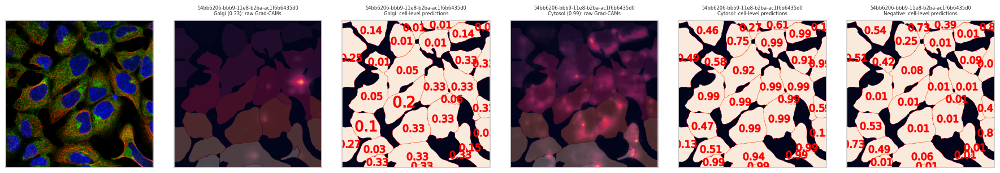

In [ ]:
vis_integrated_gradients_masks_test(
  1, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=1 probs=[0.428] cells=15


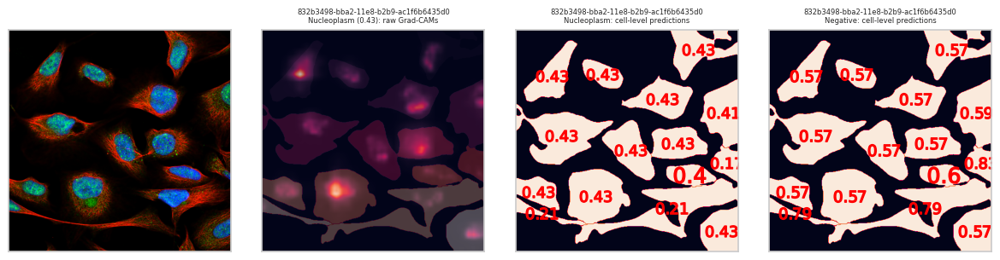

In [ ]:
vis_integrated_gradients_masks_test(
  32, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=1 probs=[0.932] cells=24


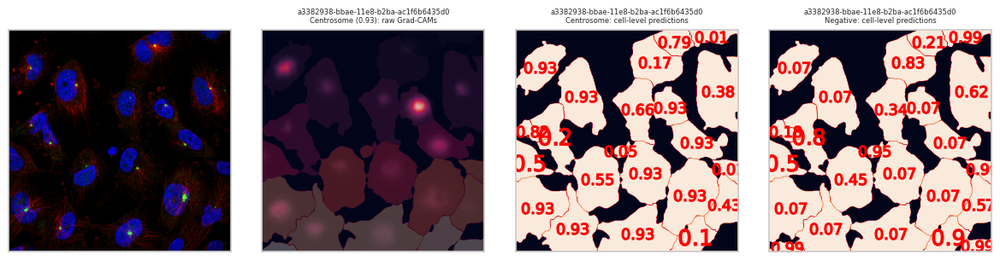

In [ ]:
vis_integrated_gradients_masks_test(
  3, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=1 probs=[0.788] cells=18


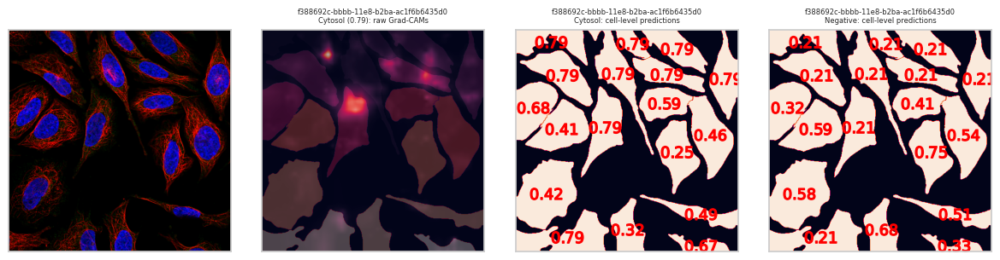

In [ ]:
vis_integrated_gradients_masks_test(
  4, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=2 probs=[0.344 0.887] cells=14


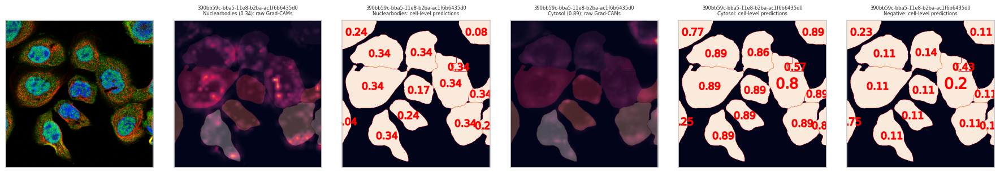

In [ ]:
vis_integrated_gradients_masks_test(
  5, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=1 probs=[0.968] cells=36


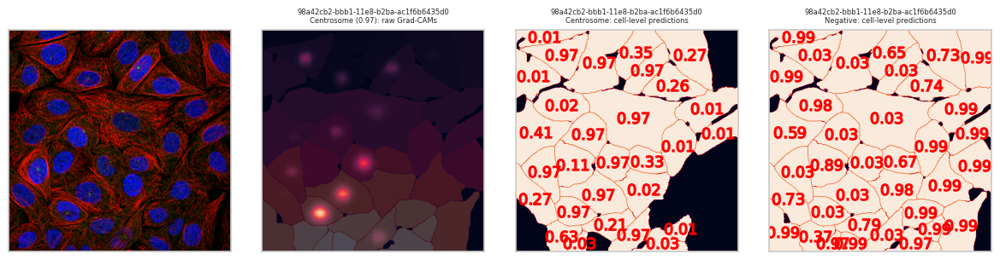

In [ ]:
vis_integrated_gradients_masks_test(
  6, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=2 probs=[0.882 0.603] cells=11


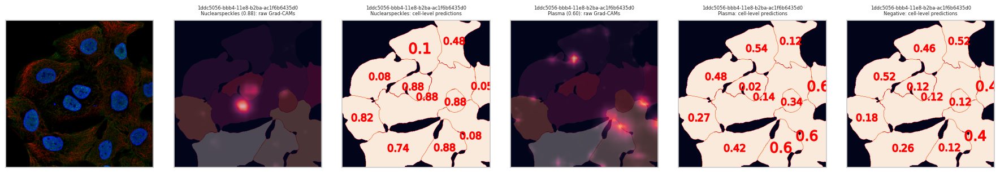

In [ ]:
vis_integrated_gradients_masks_test(
  7, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=1 probs=[0.258] cells=33


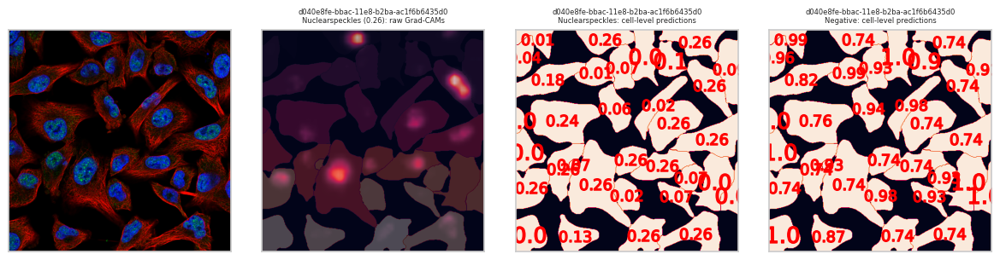

In [ ]:
vis_integrated_gradients_masks_test(
  8, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=2 probs=[0.977 0.906] cells=24


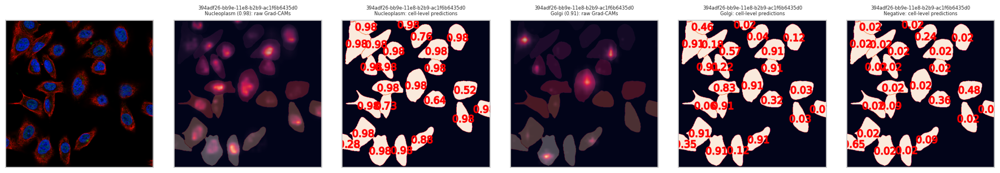

In [ ]:
vis_integrated_gradients_masks_test(
  9, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=2 probs=[0.502 0.984] cells=16


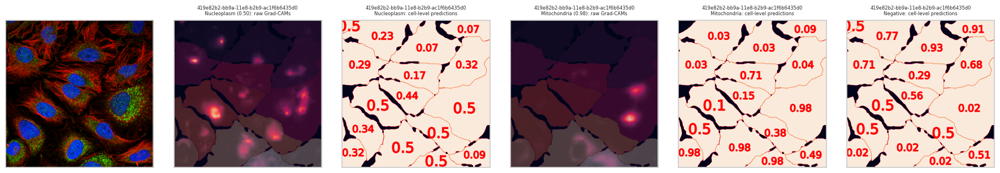

In [ ]:
vis_integrated_gradients_masks_test(
  10, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=2 probs=[0.868 0.1  ] cells=51


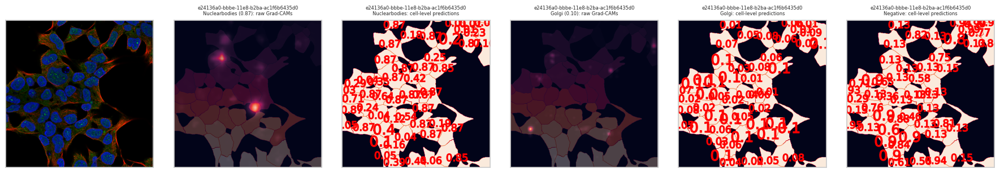

In [ ]:
vis_integrated_gradients_masks_test(
  11, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=2 probs=[0.235 0.946] cells=14


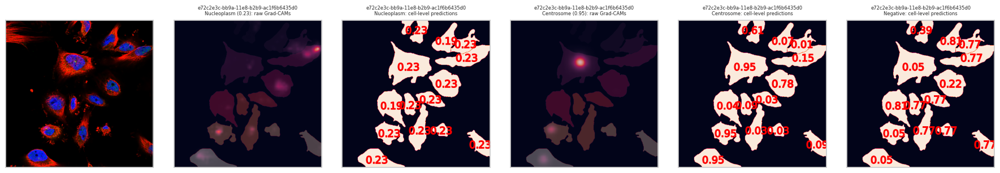

In [ ]:
vis_integrated_gradients_masks_test(
  12, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=2 probs=[0.732 0.018] cells=28


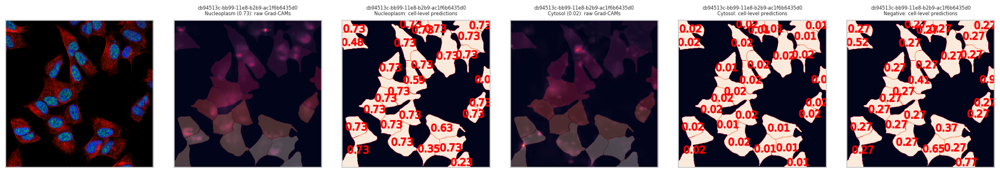

In [ ]:
vis_integrated_gradients_masks_test(
  13, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=1 probs=[0.974] cells=33


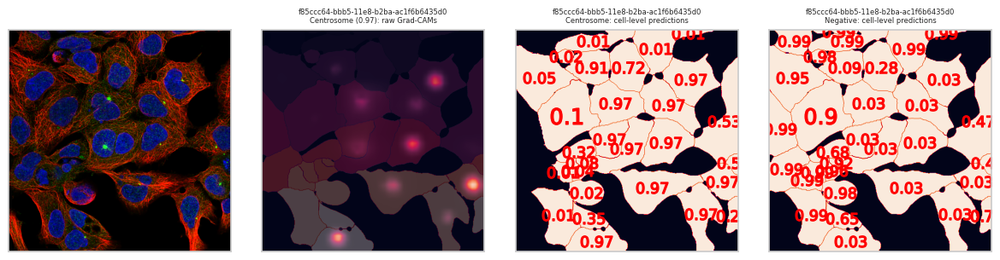

In [ ]:
vis_integrated_gradients_masks_test(
  1000, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=1 probs=[0.824] cells=26


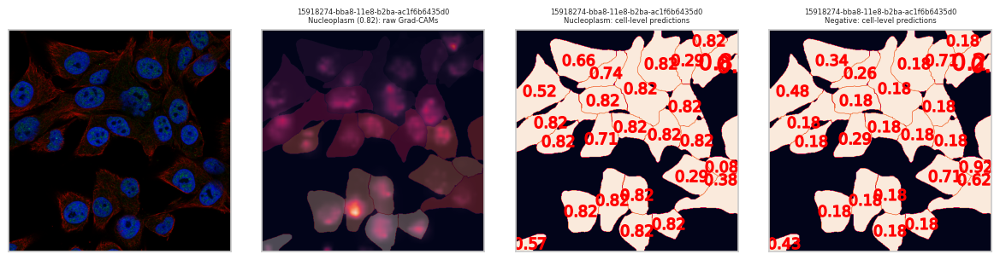

In [ ]:
vis_integrated_gradients_masks_test(
  1001, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)

preds=1 probs=[0.918] cells=17


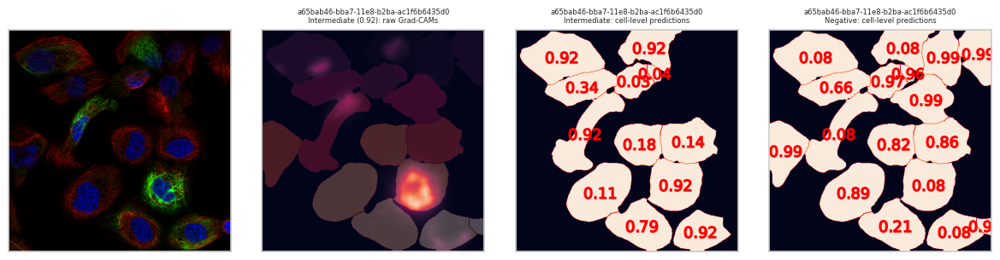

In [ ]:
vis_integrated_gradients_masks_test(
  1002, conf_threshold=0.01, mask_height=2048, mask_width=2048, max_cell_level_conf_2_image_level_conf=0.005, quantile_level=0.9, figsize=7)